
<img src="../../img/ods_stickers.jpg">

## <center> [mlcourse.ai](https://mlcourse.ai) – открытый курс OpenDataScience по машинному обучению 
    
Автор материала: Екатерина Демидова, Data Scientist @ Segmento. Материал распространяется на условиях лицензии [Creative Commons CC BY-NC-SA 4.0](https://creativecommons.org/licenses/by-nc-sa/4.0/). Можно использовать в любых целях (редактировать, поправлять и брать за основу), кроме коммерческих, но с обязательным упоминанием автора материала.
Автор материала: 

# <center>Домашнее задание № 2 (демо). <br> Визуальный анализ данных о публикациях на Хабрахабре</center>

**Заполните код в клетках и ответьте на вопросы в [веб-форме](https://docs.google.com/forms/d/1y8qj5iYpaVhczjWnZuHd5NRR_sdCGy3eTF5n-qPKknQ).**

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
%matplotlib inline 
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

# графики в svg выглядят более четкими
%config InlineBackend.figure_format = 'svg'

# увеличим дефолтный размер графиков
from pylab import rcParams

rcParams["figure.figsize"] = 8, 5

## Загрузка и знакомство с данными

Для работы вам понадобятся предобработанные данные нашего учебного конкурса на kaggle [«Прогноз популярности статьи на Хабре»](https://www.kaggle.com/c/howpop-habrahabr-favs). Скачайте [данные](https://drive.google.com/file/d/1nV2qV9otN3LnVSDqy95hvpJdb6aWtATk/view?usp=sharing) соревнования (данные были удалены с Kaggle ради организации последующего идентичного соревнования, так что тут ссылка на Google Drive).

In [3]:
# при необходимости поменяйте путь к данным
df = pd.read_csv("../../data/howpop_train.csv")

In [4]:
df.shape

(134137, 17)

In [5]:
df.head(3)

,url,domain,post_id,published,author,flow,polling,content_len,title,comments,favs,views,votes_plus,votes_minus,views_lognorm,favs_lognorm,comments_lognorm
0,https://habrahabr.ru/post/18284/,habrahabr.ru,18284,2008-01-01 18:19:00,@Tapac,develop,False,4305,Новогодний подарок блоггерам — WordPress 2.3.2,0,0,236,0.0,0.0,-0.792687,-1.344075,-2.436871
1,https://habrahabr.ru/post/18285/,habrahabr.ru,18285,2008-01-01 18:30:00,@DezmASter,design,False,7344,"Сумасшедшие яйца, или сервис для отслеживания ...",1,1,353,1.0,0.0,-0.485214,-0.831946,-1.873193
2,https://habrahabr.ru/post/18286/,habrahabr.ru,18286,2008-01-01 18:34:00,@DezmASter,design,False,8431,"Сумасшедшие яйца, или сервис для отслеживания ...",47,72,1200,45.0,5.0,0.446090,1.794023,0.574656


Избавимся сразу от переменных, названия которых заканчиваются на `_lognorm` (нужны для соревнования на Kaggle). Выберем их с помощью `filter()` и удалим `drop`-ом:

In [6]:
df.drop(
    filter(lambda x: x.endswith("_lognorm"), df.columns),
    axis=1,  # axis = 1: столбцы
    inplace=True,
)  # избавляет от необходимости сохранять датасет

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 134137 entries, 0 to 134136
Data columns (total 14 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   url          134137 non-null  object 
 1   domain       134137 non-null  object 
 2   post_id      134137 non-null  int64  
 3   published    134137 non-null  object 
 4   author       97657 non-null   object 
 5   flow         97048 non-null   object 
 6   polling      134137 non-null  bool   
 7   content_len  134137 non-null  int64  
 8   title        134137 non-null  object 
 9   comments     134137 non-null  int64  
 10  favs         134137 non-null  int64  
 11  views        134137 non-null  int64  
 12  votes_plus   133566 non-null  float64
 13  votes_minus  133566 non-null  float64
dtypes: bool(1), float64(2), int64(5), object(6)
memory usage: 13.4+ MB


In [8]:
df.describe(include=["bool", "object"])  # бинарные и категориальные переменные

,url,domain,published,author,flow,polling,title
count,134137,134137,134137,97657,97048,134137,134137
unique,134137,2,130291,22077,6,2,133628
top,https://habrahabr.ru/post/18284/,habrahabr.ru,2011-06-14 15:52:00,@alizar,develop,False,"Интересные события, произошедшие в выходные"
freq,1,97048,39,5292,53318,129412,56


In [9]:
# настройка внешнего вида графиков в seaborn
# sns.set_style("dark")
# sns.set_palette("RdBu")
# sns.set_context(
#     "notebook", font_scale=1.5, rc={"figure.figsize": (15, 5), "axes.titlesize": 18}
# )

Столбец **`published`** (время публикации) содержит строки. Чтобы мы могли работать с этими данными как с датой/временем публикации, приведём их к типу `datetime`:

In [10]:
df["published"].head(3)

0    2008-01-01 18:19:00
1    2008-01-01 18:30:00
2    2008-01-01 18:34:00
Name: published, dtype: object

In [11]:
print(df.published.dtype)
df["published"] = pd.to_datetime(df.published, yearfirst=True) 
print(df.published.dtype)

object
datetime64[ns]


Создадим несколько столбцов на основе данных о времени публикации:

In [12]:
df["year"] = [d.year for d in df.published]
df["month"] = [d.month for d in df.published]

df["dayofweek"] = [d.isoweekday() for d in df.published]
df["hour"] = [d.hour for d in df.published]

-----
Теперь Ваша очередь. В каждом пункте предлагается построить картинку и с ее помощью ответить на вопрос в [форме](https://docs.google.com/forms/d/e/1FAIpQLSf3b5OG8zX_nLQBQ-t20c6M5Auz-VUL-yxj8Fm9_o_XWDBTrg/viewform?c=0&w=1). Конечно, можно попытаться ответить на все вопросы только с Pandas, без картинок, но мы советуем Вам потренироваться строить (красивые) визуализации.   

In [13]:
df.head(3)

,url,domain,post_id,published,author,flow,polling,content_len,title,comments,favs,views,votes_plus,votes_minus,year,month,dayofweek,hour
0,https://habrahabr.ru/post/18284/,habrahabr.ru,18284,2008-01-01 18:19:00,@Tapac,develop,False,4305,Новогодний подарок блоггерам — WordPress 2.3.2,0,0,236,0.0,0.0,2008,1,2,18
1,https://habrahabr.ru/post/18285/,habrahabr.ru,18285,2008-01-01 18:30:00,@DezmASter,design,False,7344,"Сумасшедшие яйца, или сервис для отслеживания ...",1,1,353,1.0,0.0,2008,1,2,18
2,https://habrahabr.ru/post/18286/,habrahabr.ru,18286,2008-01-01 18:34:00,@DezmASter,design,False,8431,"Сумасшедшие яйца, или сервис для отслеживания ...",47,72,1200,45.0,5.0,2008,1,2,18


## 1\. В каком месяце (и какого года) было больше всего публикаций?

* март 2016
* <font color = 'green'>март 2015 </font>
* апрель 2015
* апрель 2016

In [14]:
pd.crosstab(df["year"], df['month'])

month,1,2,3,4,5,6,7,8,9,10,11,12
year,,,,,,,,,,,,
2008,435,496,545,597,635,599,674,677,914,712,661,798
2009,797,812,890,840,755,733,891,956,955,1021,1084,1049
2010,1010,1203,1257,1068,1012,1090,1152,1029,1129,1096,990,1055
2011,1124,1072,1172,1178,1159,1439,1292,1315,1363,1347,1367,1235
2012,1167,1178,1416,1330,1388,1335,1340,1318,1331,1421,1435,1313
2013,1187,1186,1327,1298,1129,1244,1244,1291,1355,1456,1452,1368
2014,1133,1218,1238,1402,1193,1237,1372,1228,1408,1595,1462,1694
2015,1504,1793,2189,2110,1799,2004,2111,1849,1944,2030,2035,2084
2016,1717,1819,2115,1910,1726,1498,1278,1278,1482,1493,0,0


In [15]:
feat = ['year', 'month']
feat

['year', 'month']

In [16]:
sns.pairplot(df[feat]);

## 2\. Проанализируйте публикации в месяце из предыдущего вопроса

Выберите один или несколько вариантов:

* <font color = 'green'><b>Один или несколько дней сильно выделяются из общей картины</font></b>
* <font color = 'green'><b> На хабре _всегда_ больше статей, чем на гиктаймсе </font></b>
* По субботам на гиктаймс и на хабрахабр публикуют примерно одинаковое число статей

Подсказки: постройте график зависимости числа публикаций от дня; используйте параметр `hue`; не заморачивайтесь сильно с ответами и не ищите скрытого смысла :)

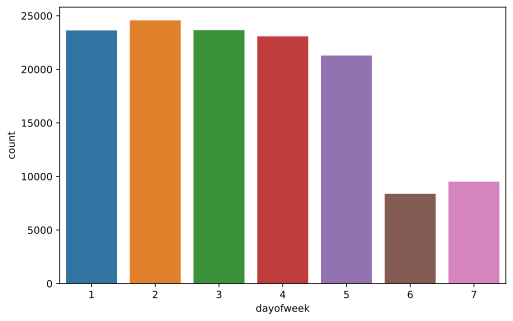

In [17]:
sns.countplot(df['dayofweek']);

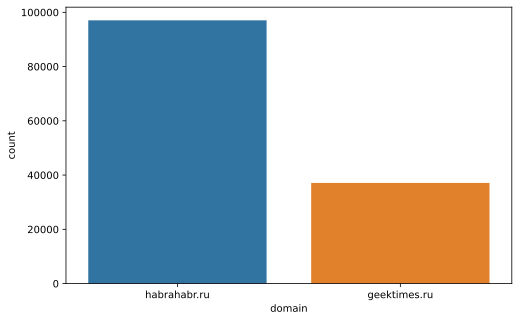

In [18]:
sns.countplot(df["domain"]);

In [19]:
pd.crosstab(df[df["dayofweek"] == 6]['dayofweek'], df['domain'])

domain,geektimes.ru,habrahabr.ru
dayofweek,,
6,2665,5715


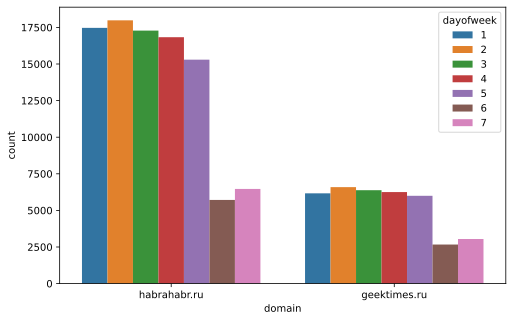

In [20]:
sns.countplot(x = 'domain', hue = 'dayofweek', data = df);

## 3\. Когда лучше всего публиковать статью?

* <font color = 'green'><b>Больше всего просмотров набирают статьи, опубликованные в 12 часов дня </b></font>
* У опубликованных в 10 утра постов больше всего комментариев
* Больше всего просмотров набирают статьи, опубликованные в 6 часов утра
* Максимальное число комментариев на гиктаймсе набрала статья, опубликованная в 9 часов вечера
* На хабре дневные статьи комментируют чаще, чем вечерние

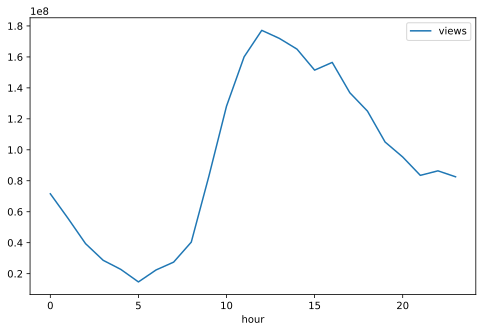

In [21]:
# hour views comments
df[['hour', 'views']].groupby('hour').sum().plot();

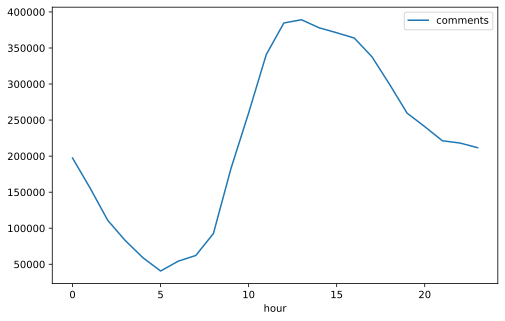

In [22]:
df[['hour', 'comments']].groupby('hour').sum().plot();

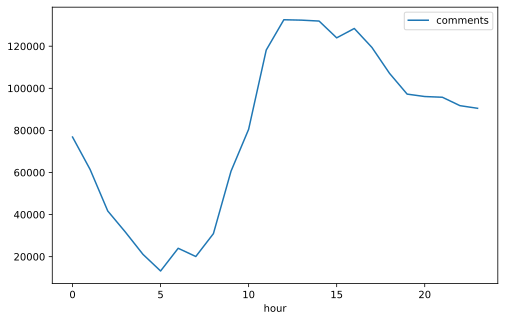

In [23]:
df[df["domain"] == 'geektimes.ru'][['comments', 'hour']].groupby('hour').sum().plot();

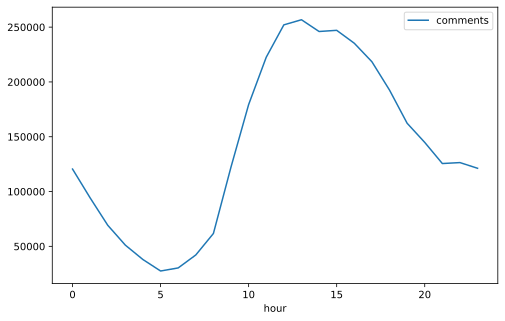

In [24]:
df[df['domain'] == 'habrahabr.ru'][['comments', 'hour']].groupby('hour').sum().plot();

## Используя plotly построим два трейса (views и comments по оси **Y**) и (hour по оси **Х**)

In [25]:
import plotly
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot, plot

init_notebook_mode(connected=True)

In [26]:
# Создадим датафрейм состоящий сгруппированный по часам с признаками views и comments
stat_df = df.groupby('hour')[['views']].sum() \
    .join(df.groupby('hour')[['comments']].count())

In [27]:
trace0 =go.Scatter(x = stat_df.index, y = stat_df["views"], name = 'Views in hour')
trace1 = go.Scatter(x = stat_df.index, y = stat_df["comments"], name = 'Comments in hour')
data = [trace0, trace1]
layout = {'title': 'Where its time to post a letter'}

fig = go.Figure(data = data, layout=layout)

iplot(fig, show_link=False)

## 4\. Кого из топ-20 авторов чаще всего минусуют?

* @Mordatyj
* @Mithgol
* <font color ='green'> @alizar </font>
* @ilya42

In [58]:
df.groupby('author')['votes_minus'].count().sort_values(ascending=False).head(20)

author
@alizar              5264
@marks               4709
@SLY_G               1939
@ivansychev          1350
@semen_grinshtein    1171
@jeston              1059
@aleksandrit          631
@XaocCPS              596
@Mithgol              555
@Mordatyj             543
@Shapelez             533
@ilya42               512
@atomlib              451
@ragequit             444
@Tylerskald           432
@andorro              278
@jasiejames           213
@lozga                200
@Sterhel              191
@Jeditobe             181
Name: votes_minus, dtype: int64

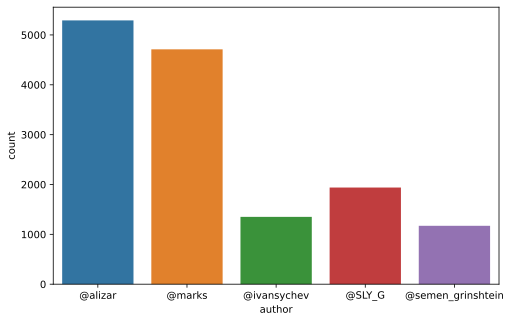

In [69]:
sns.countplot(df[df["author"]
        .isin(df.groupby('author')['votes_minus']
        .count().sort_values(ascending=False).head(5).index)]['author']);

## 5\. Сравните субботы и понедельники

Правда ли, что по субботам авторы пишут в основном днём, а по понедельникам — в основном вечером?

In [73]:
df.columns

Index(['url', 'domain', 'post_id', 'published', 'author', 'flow', 'polling',
       'content_len', 'title', 'comments', 'favs', 'views', 'votes_plus',
       'votes_minus', 'year', 'month', 'dayofweek', 'hour'],
      dtype='object')

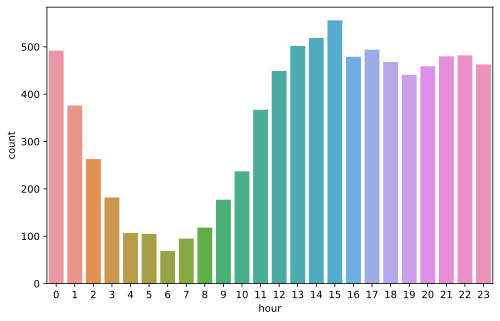

In [91]:
sns.countplot(df[df['dayofweek'] == 6]['hour']);


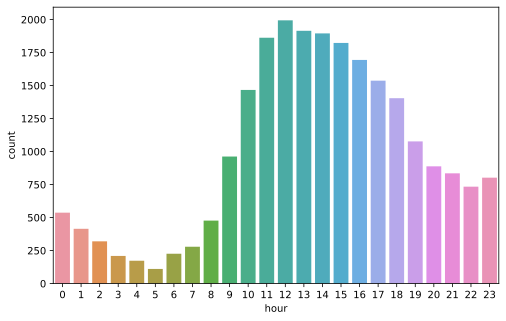

In [87]:
sns.countplot(df[df['dayofweek'] == 1]['hour']);